# Linear Regression

# predict the price of Banglore House Using LInear Regression

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split

In [2]:
df_raw=pd.read_csv("Bengaluru_House_Data.csv")

In [3]:
df_raw.shape

(13320, 9)

In [4]:
df_raw.tail()

,area_type,availability,location,size,society,total_sqft,bath,balcony,price
13315,Built-up Area,Ready To Move,Whitefield,5 Bedroom,ArsiaEx,3453,4.0,0.0,231.0
13316,Super built-up Area,Ready To Move,Richards Town,4 BHK,NaN,3600,5.0,NaN,400.0
13317,Built-up Area,Ready To Move,Raja Rajeshwari Nagar,2 BHK,Mahla T,1141,2.0,1.0,60.0
13318,Super built-up Area,18-Jun,Padmanabhanagar,4 BHK,SollyCl,4689,4.0,1.0,488.0
13319,Super built-up Area,Ready To Move,Doddathoguru,1 BHK,NaN,550,1.0,1.0,17.0


In [5]:
df=df_raw.copy()

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13320 entries, 0 to 13319
Data columns (total 9 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   area_type     13320 non-null  object 
 1   availability  13320 non-null  object 
 2   location      13319 non-null  object 
 3   size          13304 non-null  object 
 4   society       7818 non-null   object 
 5   total_sqft    13320 non-null  object 
 6   bath          13247 non-null  float64
 7   balcony       12711 non-null  float64
 8   price         13320 non-null  float64
dtypes: float64(3), object(6)
memory usage: 936.7+ KB


In [7]:
df.describe()

,bath,balcony,price
count,13247.000000,12711.000000,13320.000000
mean,2.692610,1.584376,112.565627
std,1.341458,0.817263,148.971674
min,1.000000,0.000000,8.000000
25%,2.000000,1.000000,50.000000
50%,2.000000,2.000000,72.000000
75%,3.000000,2.000000,120.000000
max,40.000000,3.000000,3600.000000


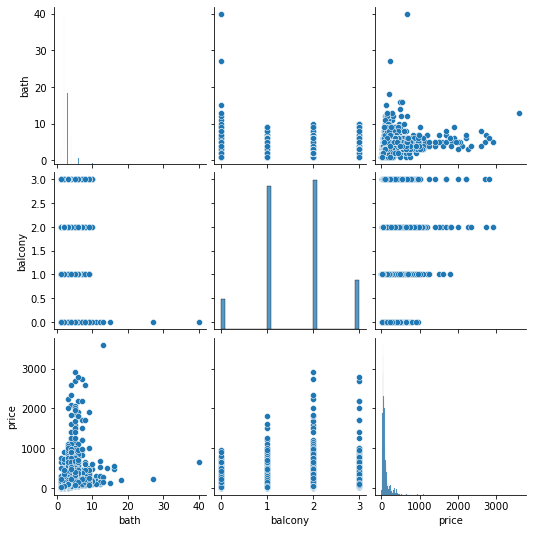

In [8]:
sns.pairplot(df)

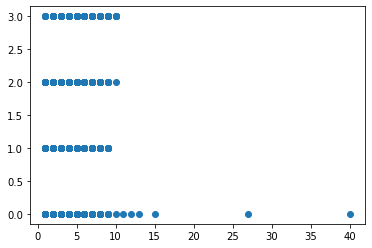

In [9]:
plt.scatter(df["bath"],df["balcony"])

In [10]:
num_vars=["bath","balcony","price"]

In [11]:
df.isnull().sum()

area_type          0
availability       0
location           1
size              16
society         5502
total_sqft         0
bath              73
balcony          609
price              0
dtype: int64

In [12]:
df.isnull().mean()*100

area_type        0.000000
availability     0.000000
location         0.007508
size             0.120120
society         41.306306
total_sqft       0.000000
bath             0.548048
balcony          4.572072
price            0.000000
dtype: float64

In [13]:
df2=df.drop("society",axis=1)
df2.isnull().sum()

area_type         0
availability      0
location          1
size             16
total_sqft        0
bath             73
balcony         609
price             0
dtype: int64

In [14]:
df2.shape

(13320, 8)

/home/neetu/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='balcony'>

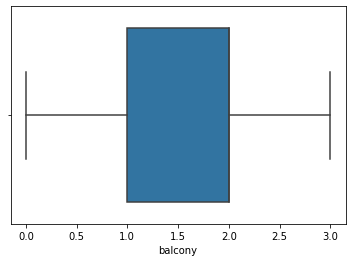

In [15]:
sns.boxplot(df2["balcony"])

In [16]:
df2["balcony"]=df2["balcony"].fillna(df2["balcony"].mean())

In [17]:
df2.isnull().sum()

area_type        0
availability     0
location         1
size            16
total_sqft       0
bath            73
balcony          0
price            0
dtype: int64

In [18]:
df3=df2.dropna()

In [19]:
df3.isnull().sum()

area_type       0
availability    0
location        0
size            0
total_sqft      0
bath            0
balcony         0
price           0
dtype: int64

In [20]:
pd.set_option("display.max_columns",None)
pd.set_option("display.max_rows",None)

In [21]:
df3["total_sqft"].value_counts()

1200                 843
1100                 221
1500                 204
2400                 195
600                  180
1000                 172
1350                 132
1050                 123
1300                 117
1250                 114
900                  112
1400                 108
1800                 104
1150                 101
1600                 100
1140                  91
2000                  82
1450                  70
1650                  69
800                   67
3000                  66
1075                  66
1020                  63
2500                  62
1160                  60
1550                  60
1125                  60
950                   59
1180                  58
1700                  58
1260                  57
1255                  56
1080                  55
1220                  55
1070                  53
700                   52
750                   52
4000                  48
1225                  48
1175                  48


In [22]:
num_vars

['bath', 'balcony', 'price']

In [23]:
for var in num_vars:
    print(df3[var].value_counts())

2.0     6908
3.0     3285
4.0     1226
1.0      788
5.0      524
6.0      273
7.0      102
8.0       64
9.0       43
10.0      13
12.0       7
13.0       3
11.0       3
16.0       2
27.0       1
18.0       1
40.0       1
15.0       1
14.0       1
Name: bath, dtype: int64
2.000000    5112
1.000000    4897
3.000000    1672
0.000000    1029
1.584376     536
Name: balcony, dtype: int64
75.000      310
65.000      302
55.000      275
60.000      270
45.000      240
50.000      235
70.000      208
90.000      203
85.000      201
80.000      185
110.000     185
150.000     180
95.000      177
100.000     177
120.000     168
40.000      167
125.000     161
130.000     134
58.000      133
48.000      127
42.000      124
35.000      123
56.000      121
46.000      119
115.000     116
52.000      116
68.000      110
140.000     110
160.000     106
200.000     103
62.000      103
78.000       91
57.000       86
72.000       86
105.000      84
135.000      84
47.000       82
180.000      82
44.000 

In [24]:
cat_var=df3.select_dtypes(include="object")
cat_var

,area_type,availability,location,size,total_sqft
0,Super built-up Area,19-Dec,Electronic City Phase II,2 BHK,1056
1,Plot Area,Ready To Move,Chikka Tirupathi,4 Bedroom,2600
2,Built-up Area,Ready To Move,Uttarahalli,3 BHK,1440
3,Super built-up Area,Ready To Move,Lingadheeranahalli,3 BHK,1521
4,Super built-up Area,Ready To Move,Kothanur,2 BHK,1200
5,Super built-up Area,Ready To Move,Whitefield,2 BHK,1170
6,Super built-up Area,18-May,Old Airport Road,4 BHK,2732
7,Super built-up Area,Ready To Move,Rajaji Nagar,4 BHK,3300
8,Super built-up Area,Ready To Move,Marathahalli,3 BHK,1310
9,Plot Area,Ready To Move,Gandhi Bazar,6 Bedroom,1020


In [25]:
df3.area_type.unique()


array(['Super built-up  Area', 'Plot  Area', 'Built-up  Area',
       'Carpet  Area'], dtype=object)

In [26]:
for var in  cat_var.columns:
    print(var +" is",df3[var].unique())

area_type is ['Super built-up  Area' 'Plot  Area' 'Built-up  Area' 'Carpet  Area']
availability is ['19-Dec' 'Ready To Move' '18-May' '18-Feb' '18-Nov' '20-Dec' '17-Oct'
 '21-Dec' '19-Sep' '20-Sep' '18-Mar' '18-Apr' '20-Aug' '19-Mar' '17-Sep'
 '18-Dec' '17-Aug' '19-Apr' '18-Jun' '22-Dec' '22-Jan' '18-Aug' '19-Jan'
 '17-Jul' '18-Jul' '21-Jun' '20-May' '19-Aug' '18-Sep' '17-May' '17-Jun'
 '18-Oct' '21-May' '18-Jan' '20-Mar' '17-Dec' '16-Mar' '19-Jun' '22-Jun'
 '19-Jul' '21-Feb' '19-May' '17-Nov' '20-Oct' '20-Jun' '19-Feb' '21-Oct'
 '21-Jan' '17-Mar' '17-Apr' '22-May' '19-Oct' '21-Jul' '21-Nov' '21-Mar'
 '16-Dec' '22-Mar' '20-Jan' '21-Sep' '21-Aug' '14-Nov' '19-Nov' '15-Nov'
 '16-Jul' '15-Jun' '17-Feb' '20-Nov' '20-Jul' '16-Sep' '15-Oct' '20-Feb'
 '15-Dec' '16-Oct' '22-Nov' '15-Aug' '17-Jan' '16-Nov' '20-Apr' '16-Jan'
 '14-Jul']
location is ['Electronic City Phase II' 'Chikka Tirupathi' 'Uttarahalli' ...
 '12th cross srinivas nagar banshankari 3rd stage' 'Havanur extension'
 'Abshot Layou

In [27]:
cat_var.columns

Index(['area_type', 'availability', 'location', 'size', 'total_sqft'], dtype='object')

In [28]:
df3.drop(columns="availability",inplace=True)

df3.shape

/home/neetu/anaconda3/lib/python3.8/site-packages/pandas/core/frame.py:4163: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


(13246, 7)

In [29]:
cat_fea=df3.select_dtypes(include=["O"]).columns
for var in  cat_fea:
    print(var +" is",len(df3[var].unique()))

area_type is 4
location is 1304
size is 31
total_sqft is 2067


In [30]:
df3.drop(columns=["location","total_sqft"],inplace=True)
df3.shape

(13246, 5)

In [31]:
df4=pd.get_dummies(df3)

In [32]:
df4.shape

(13246, 38)

In [33]:
df4.columns

Index(['bath', 'balcony', 'price', 'area_type_Built-up  Area',
       'area_type_Carpet  Area', 'area_type_Plot  Area',
       'area_type_Super built-up  Area', 'size_1 BHK', 'size_1 Bedroom',
       'size_1 RK', 'size_10 BHK', 'size_10 Bedroom', 'size_11 BHK',
       'size_11 Bedroom', 'size_12 Bedroom', 'size_13 BHK', 'size_14 BHK',
       'size_16 BHK', 'size_18 Bedroom', 'size_19 BHK', 'size_2 BHK',
       'size_2 Bedroom', 'size_27 BHK', 'size_3 BHK', 'size_3 Bedroom',
       'size_4 BHK', 'size_4 Bedroom', 'size_43 Bedroom', 'size_5 BHK',
       'size_5 Bedroom', 'size_6 BHK', 'size_6 Bedroom', 'size_7 BHK',
       'size_7 Bedroom', 'size_8 BHK', 'size_8 Bedroom', 'size_9 BHK',
       'size_9 Bedroom'],
      dtype='object')

In [34]:
X=df4.drop(columns=["price"])
y=df4["price"]

In [35]:
X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.3,random_state=55)
print("x_train ",X_train.shape)
print("x_test ",X_test.shape)
print("y_train ",y_train.shape)
print("y_train ",y_test.shape)

x_train  (9272, 37)
x_test  (3974, 37)
y_train  (9272,)
y_train  (3974,)


In [36]:
df4.to_csv("house_clean_data.csv")

In [37]:
df4

,bath,balcony,price,area_type_Built-up Area,area_type_Carpet Area,area_type_Plot Area,area_type_Super built-up Area,size_1 BHK,size_1 Bedroom,size_1 RK,size_10 BHK,size_10 Bedroom,size_11 BHK,size_11 Bedroom,size_12 Bedroom,size_13 BHK,size_14 BHK,size_16 BHK,size_18 Bedroom,size_19 BHK,size_2 BHK,size_2 Bedroom,size_27 BHK,size_3 BHK,size_3 Bedroom,size_4 BHK,size_4 Bedroom,size_43 Bedroom,size_5 BHK,size_5 Bedroom,size_6 BHK,size_6 Bedroom,size_7 BHK,size_7 Bedroom,size_8 BHK,size_8 Bedroom,size_9 BHK,size_9 Bedroom
0,2.0,1.000000,39.070,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,5.0,3.000000,120.000,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
2,2.0,3.000000,62.000,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,3.0,1.000000,95.000,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,2.0,1.000000,51.000,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5,2.0,1.000000,38.000,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6,4.0,1.584376,204.000,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0
7,4.0,1.584376,600.000,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0
8,3.0,1.000000,63.250,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
9,6.0,1.584376,370.000,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0


# feature scalling


In [38]:
from sklearn.linear_model import LinearRegression
lr=LinearRegression()
lr.fit(X_train,y_train)

LinearRegression()

In [39]:
lr.coef_

array([ 4.39330913e+01,  6.14365165e+00, -5.78155443e+00, -1.18148089e+01,
        1.75391657e+01,  5.71976237e-02,  1.17367412e+02,  1.35724602e+02,
        1.09022554e+02, -6.85369158e+01,  4.13346477e+02, -3.41060513e-13,
       -1.14234689e+02,  1.32526213e+02,  0.00000000e+00, -3.41060513e-13,
       -1.13686838e-13, -4.92117432e+02, -9.67692810e+01,  8.82035422e+01,
        1.19505287e+02, -8.30299433e+02,  9.96910084e+01,  1.31883084e+02,
        2.08068046e+02,  1.94463106e+02, -9.88911588e+02,  3.80220233e+02,
        1.38865672e+02,  6.43227324e+01,  7.22197812e+01,  1.74956234e+02,
        3.42063580e+01,  2.91441138e+01, -4.11593754e+01,  9.00876796e+00,
       -2.07165103e+01])

In [40]:
lr.intercept_

-125.95123025124012

# predict the value of home and test

In [44]:
xtest=X_test.iloc[1,:].values

In [45]:
lr.predict([xtest])

array([111.73990138])

In [43]:
y_test

1906       32.500
8977      110.000
11478      74.520
2396       41.900
8544       65.000
11837      40.000
7186      325.000
777       150.000
4499       40.000
11353      71.050
12044      57.000
6556       59.000
1523       60.000
8989       46.000
1463       29.000
11266      65.000
5386       48.000
12481     240.000
1440      135.000
11017      75.000
381        90.000
4199      165.000
8504       52.080
5838       60.000
2244       66.000
1154       56.000
6188      470.000
11471     175.000
8156       83.000
8993       45.900
9654       42.790
2290       37.800
7294       60.000
6883       68.100
2195       63.000
11502     115.000
11914      45.500
12315     170.000
10136      48.600
1570       47.000
6201       46.000
6862      145.000
9266      250.000
5269       55.000
12549      71.950
2719       56.000
12640      52.000
4112      240.000
6379       33.920
7861      138.000
1868       80.000
5858       75.000
2963      110.000
8755       65.000
3070       61.500
1512      

# Ridge Regreesion

In [46]:
from sklearn.linear_model import Ridge
from sklearn.model_selection import GridSearchCV

In [48]:
ridge=Ridge()
r_param={'alpha':[1e-10,1e-20,1e-15,50,59,90,80]}
ridge_reg=GridSearchCV(ridge,r_param,scoring='neg_mean_squared_error',cv=5)
ridge_reg.fit(X_train,y_train)
print(ridge_reg.best_params_)
print(ridge_reg.best_score_)


/home/neetu/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=4.20683e-25): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
/home/neetu/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=4.20683e-20): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,


{'alpha': 50}
-15759.802692779931


In [50]:
pred=ridge_reg.predict(X_test)

In [51]:
pred

array([ 64.52706425, 107.49613277, 115.93690181, ...,  56.0862952 ,
        15.55610936, 289.41151531])

# LAsso Regression

In [52]:
from sklearn.linear_model import Lasso
from sklearn.model_selection import GridSearchCV

In [53]:
lasso=Lasso()
l_param={'alpha':[1e-10,1e-20,1e-15,50,59,90,80]}
lasso_reg=GridSearchCV(lasso,l_param,scoring='neg_mean_squared_error',cv=5)
lasso_reg.fit(X_train,y_train)
print(lasso_reg.best_params_)
print(lasso_reg.best_score_)

/home/neetu/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:529: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 35681732.48013054, tolerance: 16487.079327887226
  model = cd_fast.enet_coordinate_descent(
/home/neetu/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:529: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 40277325.38438896, tolerance: 16186.15449786678
  model = cd_fast.enet_coordinate_descent(
/home/neetu/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:529: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 36118974.22486976, tolerance: 16367.05914794674
  model = cd_fast.enet_coordinate_descent(
/home/neetu/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_desc

{'alpha': 1e-10}
-16139.875406029509


/home/neetu/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:529: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 41830067.489525646, tolerance: 20203.78230878409
  model = cd_fast.enet_coordinate_descent(


In [54]:
pred=lasso_reg.predict(X_test)
pred

array([ 62.4629955 , 111.73990137, 117.88355303, ...,  56.31934384,
         6.2426009 , 311.86014994])